# Voorkomen van klanten die vertrekken
John is een beetje bezorgd dat zijn team niet zijn best doet om klanten te behouden. In plaats van lukraak loyaliteitsprogramma's en -technieken in te zetten, benadert hij u om te kijken of er een betere manier is om te voorspellen welke klanten niet tevreden zijn. 

# 1. Import Data

In [1]:
# installeren
!pip install ydata-profiling ipywidgets


[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
# importeren
import pandas as pd 

In [3]:
# data importeren
df = pd.read_csv('classificationdata.csv', index_col='id')

In [4]:
# check
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


# 2. Split Data om Snooping Bias te voorkomen

In [5]:
# importeren
from sklearn.model_selection import train_test_split

In [6]:
# train test split
train, test = train_test_split(df, test_size=0.3, random_state=1234)

# 3. Exploratory Data Analysis (EDA)

## Algemene EDA

In [7]:
# importeren
from matplotlib import pyplot as plt

In [8]:
# informatie
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12070 entries, 16692 to 1318
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     12070 non-null  object 
 1   tenure                         12070 non-null  int64  
 2   contract_length                12041 non-null  float64
 3   promotions_offered             12041 non-null  object 
 4   remaining_term                 12041 non-null  float64
 5   last_nps_rating                12041 non-null  float64
 6   area_code                      12063 non-null  object 
 7   international_plan             12070 non-null  object 
 8   voice_mail_plan                12050 non-null  object 
 9   number_vmail_messages          12070 non-null  int64  
 10  total_day_minutes              12070 non-null  float64
 11  total_day_calls                12070 non-null  int64  
 12  total_day_charge               12070 non-nu

In [9]:
# aantal null values
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered               29
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [10]:
# statistische samenvatting
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,12070.000000,12041.000000,12041.000000,12041.000000,12070.000000,12070.000000,12070.000000,12070.000000,12058.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000
mean,100.310771,15.924840,11.137115,6.102815,8.638608,179.821368,100.064374,30.574659,200.288303,100.416984,17.014347,199.546252,99.791881,8.979010,10.300118,4.961806,2.774743,1.555344
std,39.742023,4.904918,7.212212,2.723722,13.030305,54.694309,20.137844,9.301168,50.899001,19.898596,4.319807,50.871813,20.195931,2.285268,2.804826,2.508605,0.750105,1.317849
min,1.000000,8.000000,1.000000,1.000000,0.000000,1.383902,1.000000,0.119603,7.605489,1.000000,1.052621,4.247707,1.000000,0.472320,0.032252,0.000000,0.013478,0.000000
25%,73.000000,12.000000,5.000000,4.000000,1.000000,142.621175,87.000000,24.323777,166.719227,87.000000,14.152096,165.683627,86.000000,7.446210,8.529475,3.000000,2.299756,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,179.705079,100.000000,30.517433,200.746807,101.000000,17.049083,198.635687,99.000000,8.952996,10.382980,5.000000,2.812103,1.000000
75%,127.000000,20.000000,17.000000,8.000000,16.000000,217.024361,113.000000,36.834662,233.943152,114.000000,19.870764,234.236992,114.000000,10.520554,12.066125,6.000000,3.256842,2.000000
max,238.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.474658,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


In [11]:
# statistische samenvatting van objects
train.describe(include='object')

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,12070,12041,12063,12070,12050,12041
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,398,10957,6049,10957,8887,10314


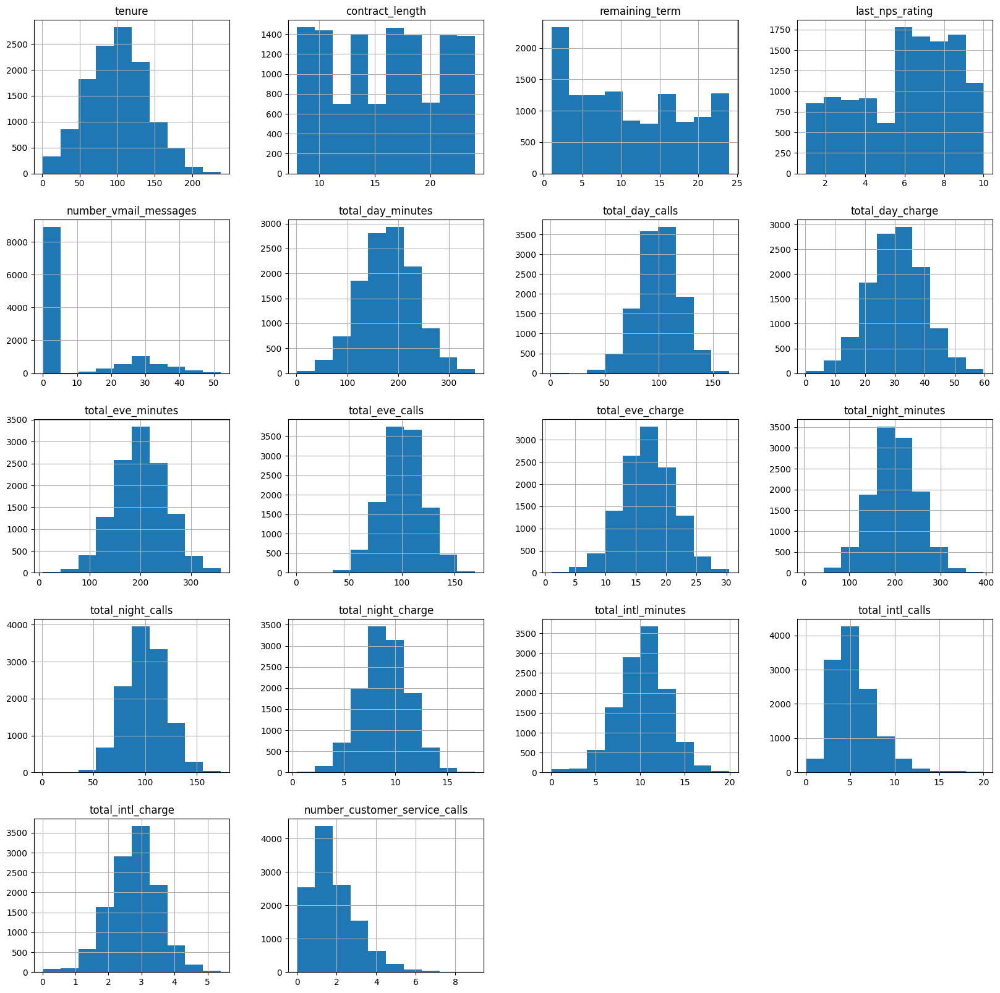

In [12]:
# histogrammen
train.hist(figsize=(20,20))
plt.show()

## Sneller EDA met Pandas Profiling

In [13]:
# importeren
from ydata_profiling import ProfileReport

In [14]:
# Creëer profile report
profile = ProfileReport(train, title='Profile Report')

In [15]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analyse Categorical Features

### Target Features onderzoeken

In [16]:
# import 
import seaborn as sns

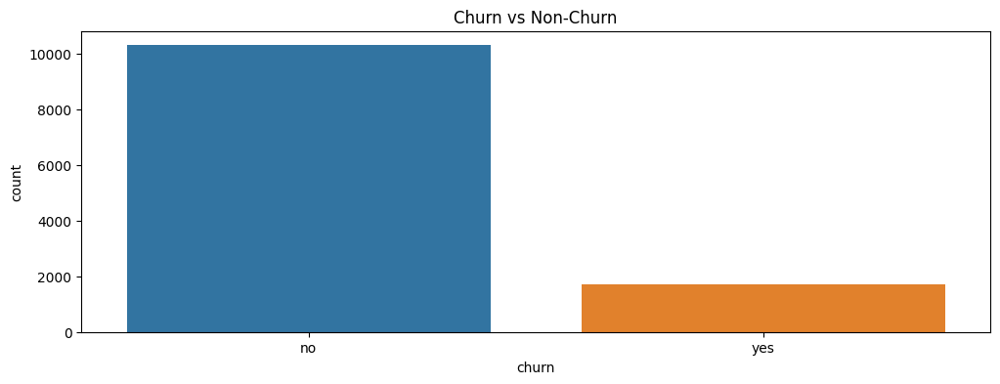

In [17]:
# visualiseer target feature
plt.figure(figsize=(12,4))
sns.countplot(
    data=train,
    x='churn'
).set_title('Churn vs Non-Churn')
plt.show()

Inbalanced dataset: deze moet gebalanceerd worden.

### Onderzoek State, Area Code en Promotions Offered

In [18]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

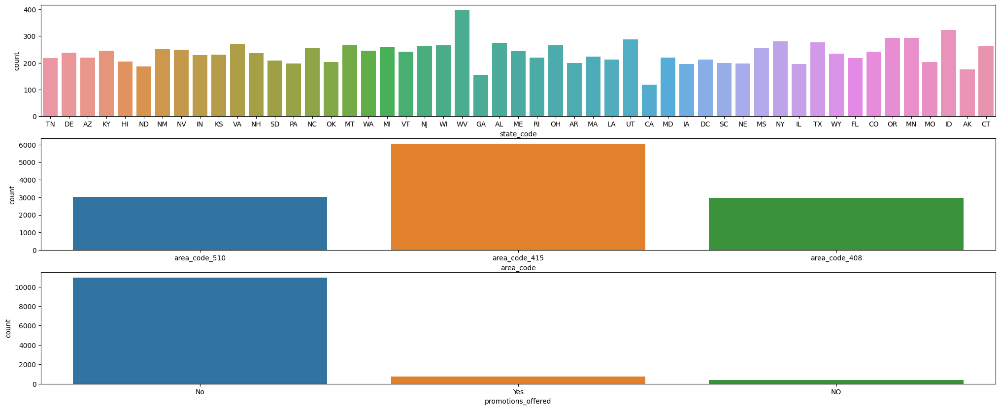

In [19]:
#Plotting meerdere charts in zelfde afbeelding
fig, axs = plt.subplots(3, figsize=(25,10))

sns.countplot(
    data=train,
    x='state_code',
    ax=axs[0]
)

sns.countplot(
    data=train,
    x='area_code',
    ax=axs[1]
)

sns.countplot(
    data=train,
    x='promotions_offered',
    ax=axs[2]
)

plt.show()

## Analyse Numeric Features

### Onderzoek Vmail messages en Customer Service Calls

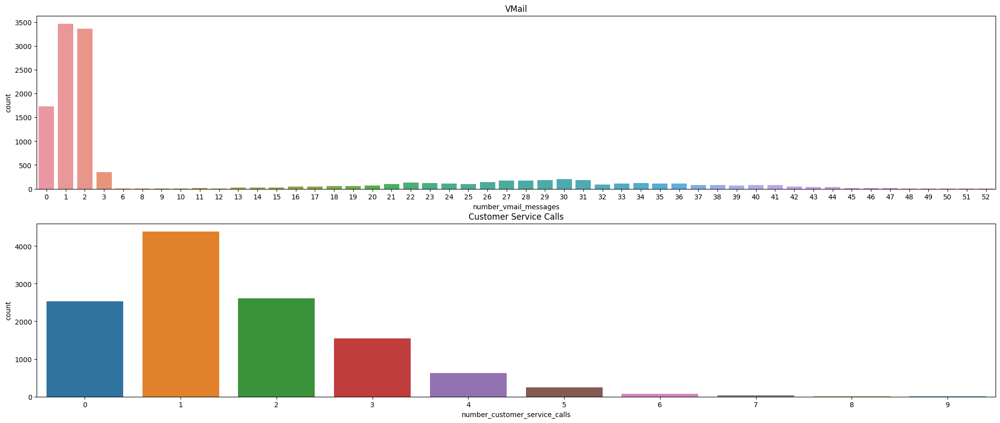

In [20]:
# Plot meerdere charts in afbeelding
fig, axs = plt.subplots(2, figsize=(25,10))

sns.countplot(
    data=train,
    x='number_vmail_messages',
    ax=axs[0]
).set_title('VMail')

sns.countplot(
    data=train,
    x='number_customer_service_calls',
    ax=axs[1]
).set_title('Customer Service Calls')

plt.show()

### Analyse Skewness van Customer Service Calls

In [21]:
# importeren
import numpy as np

In [22]:
# skewness checken
train['number_customer_service_calls'].skew()

1.086776733503893

In [23]:
# log transformation
train['log_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)

In [24]:
# skewness opnieuw checken
train['log_customer_service_calls'].skew()

-0.11828354478767099

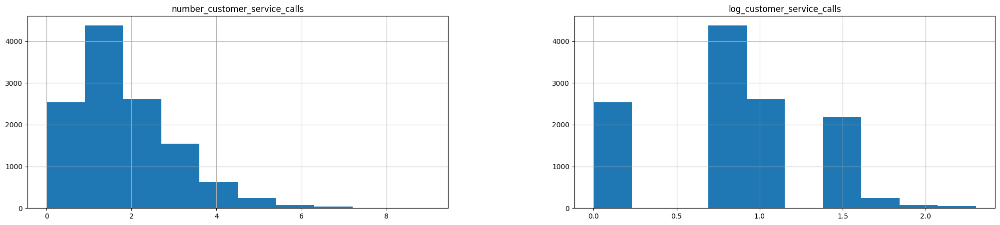

In [25]:
# visualiseren van de skewness
train[['number_customer_service_calls', 'log_customer_service_calls']].hist(figsize=(25,5))
plt.show()

In [26]:
# drop de nieuwe kolom 
train.drop('log_customer_service_calls', axis=1, inplace=True)

## Analyse Relationships

### Numeric/Numeric Correlation

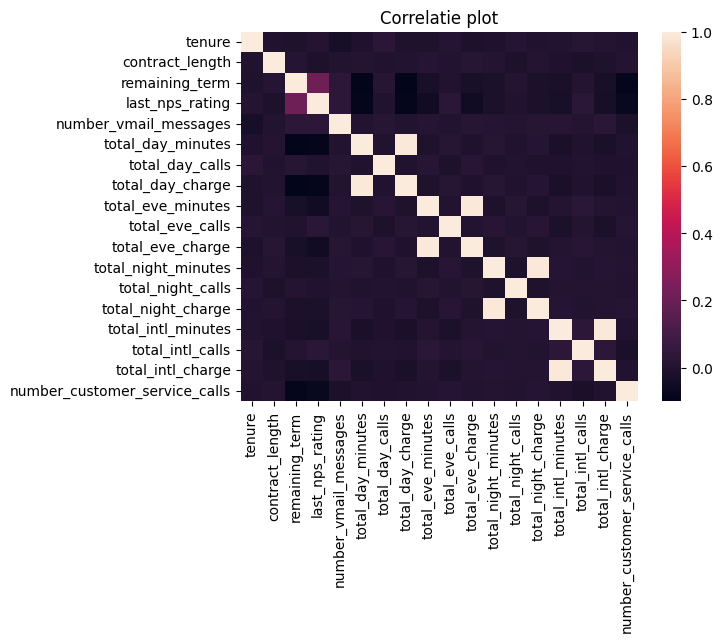

In [27]:
# correlation heatmap
sns.heatmap(train.select_dtypes(exclude='object').corr()).set_title('Correlatie plot')
plt.show()

In [28]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

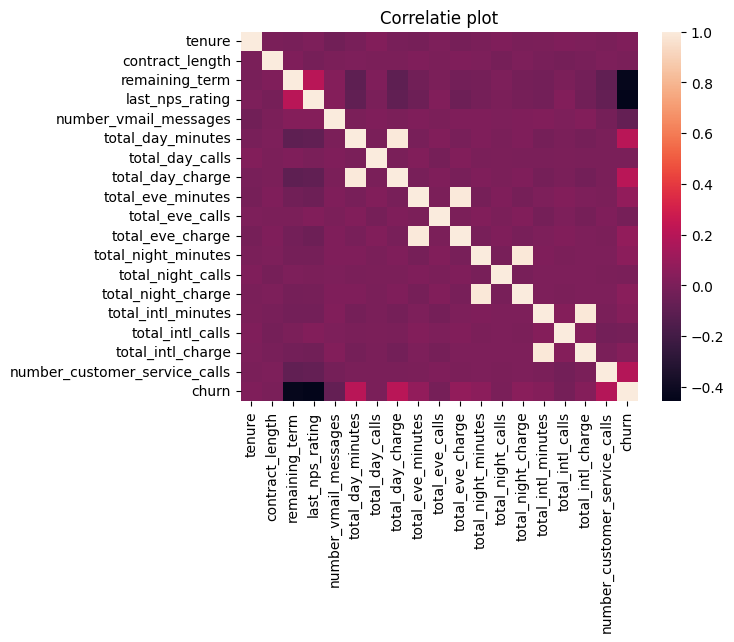

In [29]:
# Maak van churn, 0 en 1 waardes om deze te kunnen zien in de heatmap
temp = train.copy()
temp['churn'] = temp['churn'].apply(lambda x: 1 if x=='yes' else 0)
sns.heatmap(temp.select_dtypes(exclude='object').corr()).set_title('Correlatie plot')
plt.show()

### Plot Churn Distributions

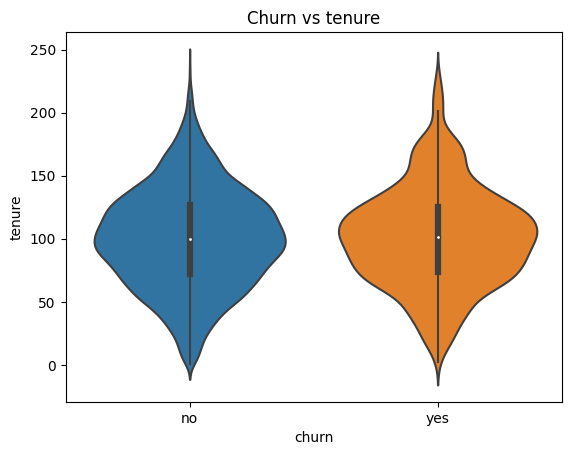

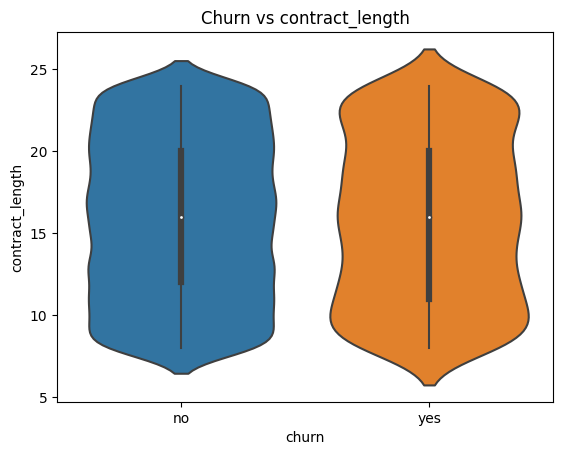

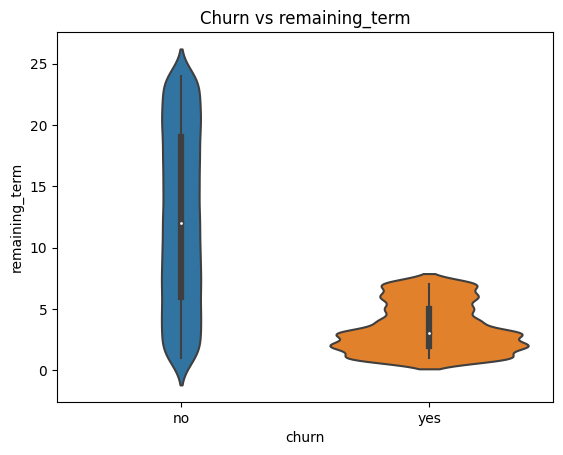

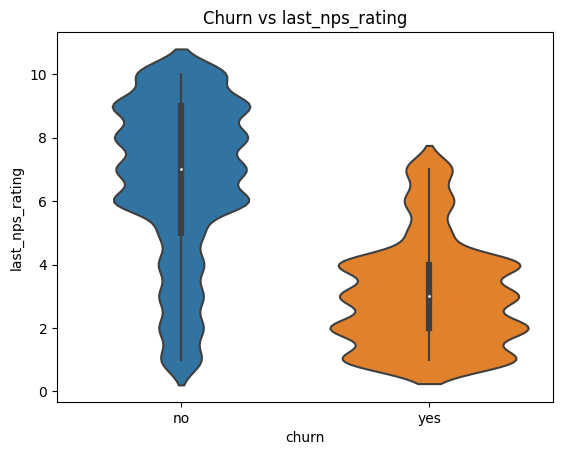

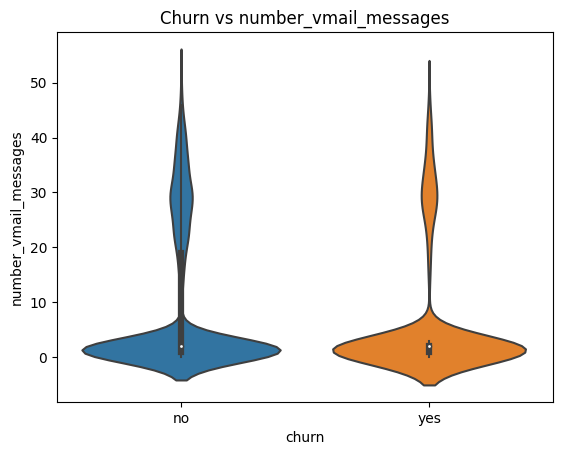

...

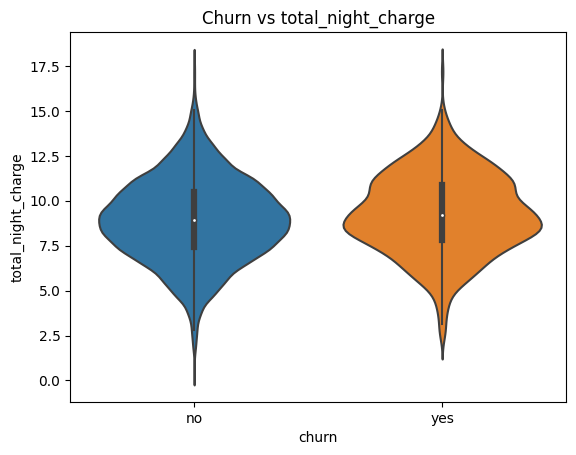

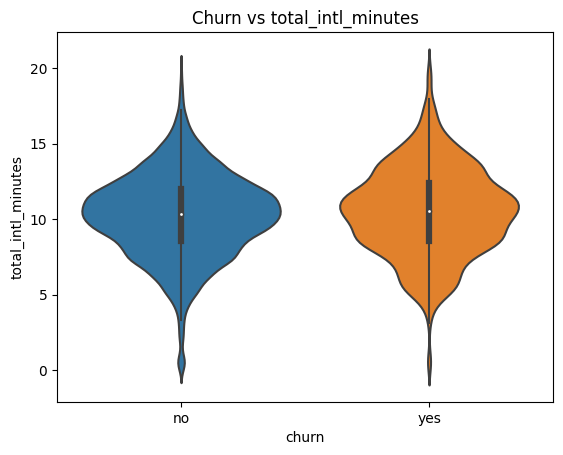

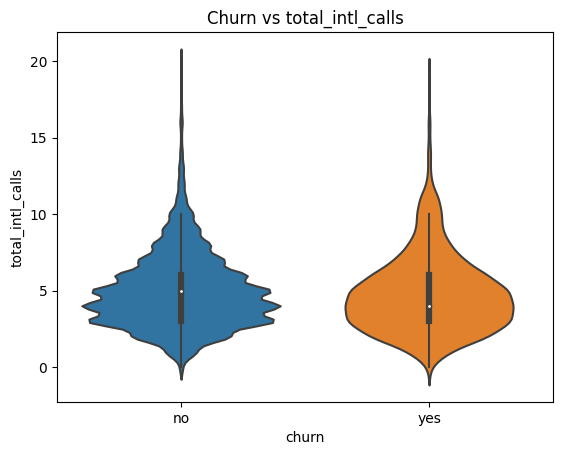

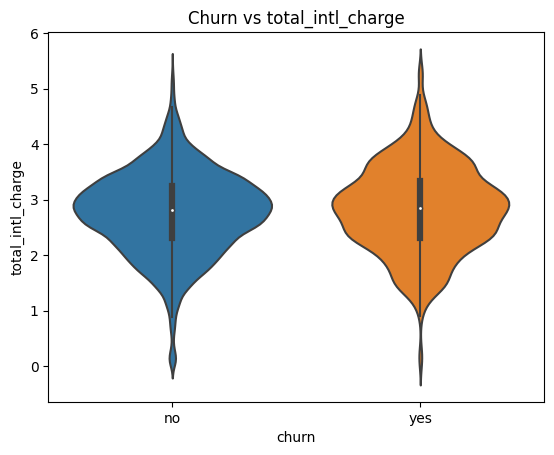

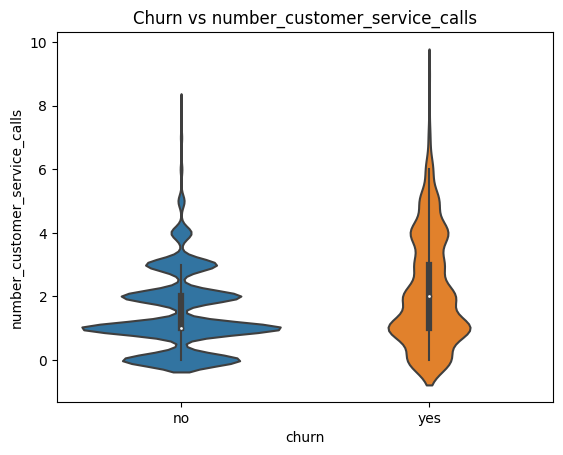

In [30]:
# ploting churn distributions
for col in train.select_dtypes(exclude='object').columns:
    sns.violinplot(data=train, x='churn', y=col).set_title(f'Churn vs {col}')
    plt.show()

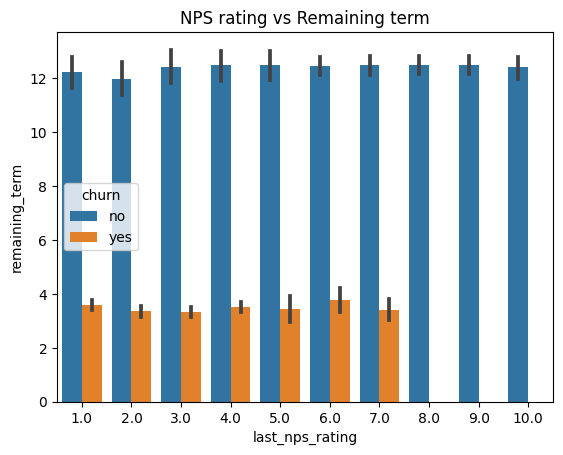

In [31]:
sns.barplot(
    data=train,
    x='last_nps_rating',
    y='remaining_term',
    hue='churn'
).set_title('NPS rating vs Remaining term')
plt.show()

### Categorical Relationships to Churn

In [32]:
# unieke waardes van promotions
train.promotions_offered.unique()

array(['No', 'Yes', 'NO', nan], dtype=object)

In [33]:
# vervang de nan en NO naar No
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [34]:
# check
train.promotions_offered.unique()

array(['No', 'Yes'], dtype=object)

In [35]:
# crosstab in procenten
for col in train.select_dtypes(include='object').columns:
    display(pd.crosstab(train[col], train['churn']) / len(train))

churn,no,yes
state_code,,
AK,0.013670,0.000829
AL,0.019553,0.002900
AR,0.014167,0.002403
AZ,0.016321,0.001657
CA,0.007539,0.002237
CO,0.017647,0.002237
CT,0.018558,0.003231
DC,0.014250,0.003065
DE,0.016239,0.003480


churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


churn,no,yes
area_code,,
area_code_408,0.210025,0.036205
area_code_415,0.430655,0.069097
area_code_510,0.213256,0.037780


churn,no,yes
international_plan,,
no,0.796935,0.108451
yes,0.057581,0.034631


churn,no,yes
voice_mail_plan,,
no,0.616321,0.118973
yes,0.237117,0.023529


churn,no,yes
churn,,
no,0.854515,0.000000
yes,0.000000,0.143082


### Is er een relatie tussen Remaining term en NPS Rating? Of promotions offered?
Namely when Remaining term < 5 and Last nps rating < 7

In [36]:
# Creëeren van 0 en 1 
train['nps_less_7'] = (train['last_nps_rating'] <= 7).astype(int)
train['remaining_term_less_5'] = (train['remaining_term'] < 5).astype(int)
train['churn_yes'] = train['churn'].apply(lambda x: 1 if x=='yes' else 0)
train['churn_no'] = train['churn'].apply(lambda x: 0 if x=='yes' else 1)

In [37]:
# Check
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,nps_less_7,remaining_term_less_5,churn_yes,churn_no
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,9.332900,8.308312,9,2.208759,2,no,0,0,0,1
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,10.263007,8.238645,2,2.168779,1,yes,1,0,1,0
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,5.731597,11.084169,5,3.153671,0,no,0,0,0,1
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,9.407576,19.981388,4,5.242569,0,no,1,0,0,1
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,10.800377,11.670808,9,3.205746,2,no,1,0,0,1


In [38]:
# groeperen
train.groupby(['nps_less_7', 'remaining_term_less_5']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.000000  0.305220
           1                       0.000000  0.061392
1          0                       0.043331  0.405468
           1                       0.099751  0.084838

In [39]:
# groeperen
train.groupby(['nps_less_7', 'remaining_term_less_5', 'promotions_offered']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.000000  0.305220
           1                     No                   0.000000  0.061392
1          0                     No                   0.035543  0.405468
                                 Yes                  0.007788  0.000000
           1                     No                   0.080116  0.052361
                                 Yes                  0.019635  0.032477

In [40]:
# droppen van de aangemaakte kolommen
train.drop(['nps_less_7', 'remaining_term_less_5', 'churn_yes', 'churn_no'], axis=1, inplace=True)

In [41]:
# check
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

# 4. Data Preprocessing

## Check of alle kolommen het zelfde zijn als bij de start

In [42]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

## Missing Area Code Data - Categorical

In [43]:
# check nulls
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [44]:
train[train['area_code'].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no


In [45]:
# vul NaN met missing
train['area_code'] = train['area_code'].fillna('missing')

In [46]:
# check
train[train['area_code']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,missing,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,missing,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
16450,FL,147,16.0,No,9.0,8.0,missing,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
12972,MO,153,24.0,No,13.0,6.0,missing,yes,no,0,...,98,8.515226,207.015705,92,9.090795,7.466579,6,2.008288,0,no


In [47]:
# check nulls
train.isnull().sum()['area_code']

0

## Missing Voice Mail Plan - Categorical

In [48]:
# vul NaN met missing
train['voice_mail_plan'] = train['voice_mail_plan'].fillna('missing')

In [49]:
# check nulls
train.isnull().sum()['voice_mail_plan']

0

In [50]:
# check
train[train['voice_mail_plan']=='missing'][['voice_mail_plan']].head()

,voice_mail_plan
id,
16429,missing
10372,missing
11974,missing
3365,missing
17168,missing


## Missing Evening Minutes - Numeric

In [51]:
# check missing 
train[train['total_eve_minutes'].isnull()][['total_eve_minutes','churn']]

,total_eve_minutes,churn
id,,
16142,NaN,no
17168,NaN,no
4558,NaN,no
11193,NaN,yes
15828,NaN,no
12703,NaN,yes
2729,NaN,no
11475,NaN,no
15905,NaN,no


In [52]:
# vul in de mean bij missing values + check
mean_eve_mins = train['total_eve_minutes'].mean().round(2)
mean_eve_mins

200.29

In [53]:
# Maak missing-flag en vul de mean in bij de missing values
train['total_eve_minutes_missing'] = train['total_eve_minutes'].isnull().astype(int)
train['total_eve_minutes'] = train['total_eve_minutes'].fillna(mean_eve_mins)

In [54]:
# check nulls
train.isnull().sum()['total_eve_minutes']

0

In [55]:
# check total eve minutes missing
train[train['total_eve_minutes_missing']==1][['total_eve_minutes_missing', 'total_eve_minutes']].head()

,total_eve_minutes_missing,total_eve_minutes
id,,
16142,1,200.29
17168,1,200.29
4558,1,200.29
11193,1,200.29
15828,1,200.29


## Missing Target Variables

In [56]:
# check nulls
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [57]:
train[train['churn'].isnull()][['contract_length', 'remaining_term', 'last_nps_rating', 'churn']]

,contract_length,remaining_term,last_nps_rating,churn
id,,,,
16332,NaN,NaN,NaN,NaN
7783,NaN,NaN,NaN,NaN
5127,NaN,NaN,NaN,NaN
14246,NaN,NaN,NaN,NaN
1612,NaN,NaN,NaN,NaN
2332,NaN,NaN,NaN,NaN
3544,NaN,NaN,NaN,NaN
5704,NaN,NaN,NaN,NaN
12038,NaN,NaN,NaN,NaN


In [58]:
# droppen van NaN values van churn (en de andere kolommen automatisch)
train = train[~train['churn'].isnull()]

In [59]:
# check
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

# 5. Feature Engineering

## Ratio voor Correlated Predictor Variables

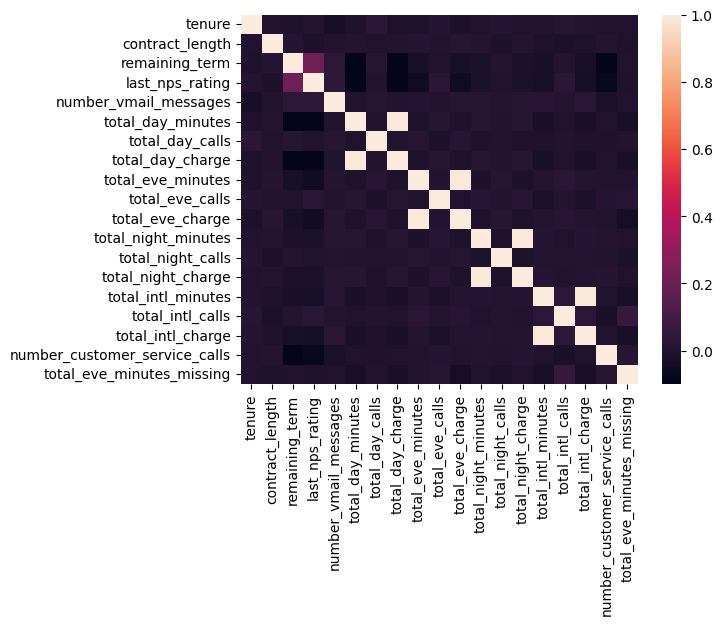

In [60]:
# correlation heatmap
sns.heatmap(train.select_dtypes(exclude='object').corr())
plt.show()

In [61]:
# Maak nieuwe featues van de sterk collererende featues
train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes'] 
train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes'] 
train['night_ratio'] = train['total_night_charge'] / train['total_night_minutes'] 
train['intl_ratio'] = train['total_intl_charge'] / train['total_intl_minutes'] 

C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\3297502959.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\3297502959.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\3297502959.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

In [62]:
# check
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,8.308312,9,2.208759,2,no,0,0.172815,0.083632,0.043008,0.265849
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,8.238645,2,2.168779,1,yes,0,0.169215,0.084485,0.045763,0.263245
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,11.084169,5,3.153671,0,no,0,0.158396,0.088938,0.046510,0.284520
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,19.981388,4,5.242569,0,no,0,0.178475,0.086951,0.043587,0.262373
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,11.670808,9,3.205746,2,no,0,0.168656,0.081817,0.043780,0.274681


In [63]:
# droppen van 'oude' features
train.drop(['total_day_charge', 'total_day_minutes', 'total_eve_charge', 'total_eve_minutes', 'total_night_charge', 'total_night_minutes', 'total_intl_charge', 'total_intl_minutes'], axis=1, inplace=True)

C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\2896811040.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.drop(['total_day_charge', 'total_day_minutes', 'total_eve_charge', 'total_eve_minutes', 'total_night_charge', 'total_night_minutes', 'total_intl_charge', 'total_intl_minutes'], axis=1, inplace=True)


In [64]:
# check
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'churn', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio'],
      dtype='object')

## Skewed Customer Service Calls

C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\3551061566.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['number_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)


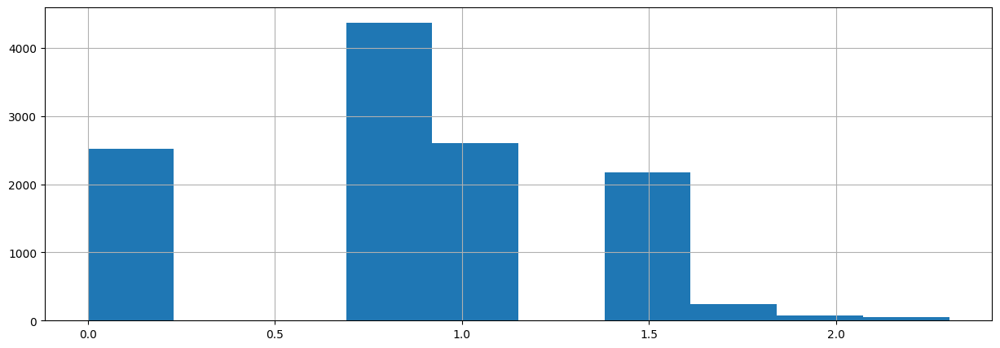

In [65]:
# log transformatie
train['number_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)
train['number_customer_service_calls'].hist(figsize=(15,5))
plt.show()

## Feature Engineering Unhappy Customers

In [66]:
# promotions_offered NO en Nan naar No
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\866781706.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')


In [67]:
#check
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_calls                  0
total_eve_calls                  0
total_night_calls                0
total_intl_calls                 0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
day_ratio                        0
eve_ratio                        0
night_ratio                      0
intl_ratio                       0
dtype: int64

In [68]:
# nieuwe unhappy customers aanmaken
train['unhappy_customers'] = ((train.remaining_term < 5) & (train.last_nps_rating <=7) & (train.promotions_offered == 'No')).astype(int)

C:\Users\stefa\AppData\Local\Temp\ipykernel_13376\220970594.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['unhappy_customers'] = ((train.remaining_term < 5) & (train.last_nps_rating <=7) & (train.promotions_offered == 'No')).astype(int)


In [69]:
# check
train[['unhappy_customers', 'churn']]

,unhappy_customers,churn
id,,
16692,0,no
6970,0,yes
9747,0,no
16099,0,no
8833,0,no
...,...,...
1182,0,no
8222,0,no
8471,0,no


## Creëer Target en Feature Variables

In [70]:
# import
from sklearn.preprocessing import OneHotEncoder

In [71]:
# Train splitten in X en y
X_train = train.drop('churn', axis=1)
y_train = np.where(train['churn']=='yes', 1, 0)

In [72]:
# check
y_train

array([0, 1, 0, ..., 0, 0, 0])

In [73]:
# check
print(X_train.shape)
print(y_train.shape)

(12041, 21)
(12041,)


In [74]:
# one hot encode
onehot= OneHotEncoder(handle_unknown='ignore')
# Pas toe op de categorical kolommen
encoded_columns = onehot.fit_transform(X_train.select_dtypes(include='object')).toarray()

In [75]:
# check
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [76]:
# onehot toevoegen
X_train = X_train.select_dtypes(exclude='object')
X_train[onehot.get_feature_names_out()] = encoded_columns

In [77]:
# check
X_train.columns

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

## Imbalanced Classes oplossen

In [78]:
# installeren
!pip install imblearn


[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [79]:
# importeren
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

In [80]:
# Creëer de SMOTE class
sm = SMOTE(random_state=1234)
# Resample om te balanceren
X_train, y_train = sm.fit_resample(X_train, y_train)

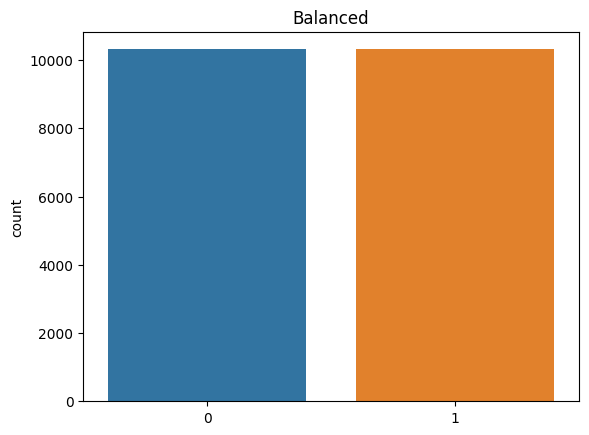

In [81]:
# check
sns.countplot(x=y_train).set_title('Balanced')
plt.show()

# 6. Modelling

## Pipelines bouwen

In [82]:
# importeren
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [83]:
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [84]:
pipelines = {
    'sgd': make_pipeline(StandardScaler(), SGDClassifier()),
    'ridge': make_pipeline(StandardScaler(), RidgeClassifier()),
    'rf': make_pipeline(StandardScaler(), RandomForestClassifier()),
    'gb': make_pipeline(StandardScaler(), GradientBoostingClassifier()),
    'xg': make_pipeline(StandardScaler(), XGBClassifier())
}

## Grids bouwen


In [85]:
grid = {
    'sgd':{
        'sgdclassifier__alpha':[0.00001, 0.0001, 0.001, 0.01]
    },
    'ridge':{
        'ridgeclassifier__alpha':[0.01, 0.5, 1.0, 2.0, 3.0]
    },
    'rf':{
        'randomforestclassifier__n_estimators':[50, 100, 200, 300],
        'randomforestclassifier__max_depth':[None, 3, 5, 7, 9]
    },
    'gb':{
        'gradientboostingclassifier__n_estimators':[50,100,200,300],
        'gradientboostingclassifier__max_depth':[None, 3, 5, 7, 9]
    },
    'xg':{
        'xgbclassifier__n_estimators':[50,100,200,300],
        'xgbclassifier__max_depth':[None, 3, 5, 7, 9]
    }
}

## Train Models

In [86]:
# importeren
from sklearn.model_selection import GridSearchCV

In [87]:
# loop door models
fit_models = {}
for algo, pipeline in pipelines.items():
    try:
        print(f'Training: {algo}')
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10)
        model.fit(X_train, y_train)
        fit_models[algo] = model
    except Exception as e:
        print(f'There was an error training the {algo} model, {e}')

Training: sgd
Training: ridge
Training: rf
Training: gb
Training: xg


# 7. Evaluation

## Apply Transformations to Test Data

In [88]:
# Haal de kolom volgorde op
col_order = X_train.columns; col_order

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

In [99]:
# Maak functie voor data tranformatie
def transform_data(test_df, col_order, mean_eve_mins, onehot): 
    # Copy dataframe
    X = test_df.copy()
    
    # DP - Missing Values
    X['area_code'] =  X['area_code'].fillna('missing')
    X['voice_mail_plan'] = X['voice_mail_plan'].fillna('missing')
    X['total_eve_minutes_missing'] = X['total_eve_minutes'].isnull().astype(int)
    X['total_eve_minutes'] = X['total_eve_minutes'].fillna(mean_eve_mins)
    
    # FE - Ratios
    X['day_ratio'] = X['total_day_charge'] / X['total_day_minutes']
    X['eve_ratio'] = X['total_eve_charge'] / X['total_eve_minutes']
    X['night_ratio'] = X['total_night_charge'] / X['total_night_minutes']
    X['intl_ratio'] = X['total_intl_charge'] / X['total_intl_minutes']
    X = X.drop(['total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','total_day_minutes','total_eve_minutes','total_night_minutes', 'total_intl_minutes'], axis=1)
    
    # FE - Log Transform
    X['number_customer_service_calls'] = np.log(X['number_customer_service_calls']+1)
    
    # FE - Unhappy Customers 
    X['promotions_offered'] = X['promotions_offered'].replace(['NO', np.NaN], 'No')
    X['unhappy_customers'] = ((X.remaining_term < 5) 
                              & (X.last_nps_rating <=7) 
                              & (X.promotions_offered == 'No')).astype(int)
    
    # Onehot encoder 
    encoded_columns = onehot.transform(X.select_dtypes(include='object')).toarray()
    X = X.select_dtypes(exclude='object')
    X[onehot.get_feature_names_out()] = encoded_columns
    
    return X[col_order]

In [100]:
# Drop NaN van churn 
test = test[~test['churn'].isnull()]

In [101]:
# Check
test.isnull().sum()

state_code                        0
tenure                            0
contract_length                   0
promotions_offered                0
remaining_term                    0
last_nps_rating                   0
area_code                         5
international_plan                0
voice_mail_plan                  10
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 6
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

In [102]:
# Splitten van Test data
X_test = transform_data(test.drop('churn', axis=1), col_order, mean_eve_mins, onehot)
y_test = np.where(test['churn']=='yes', 1, 0)

In [106]:
print(X_test.shape)
print(y_test.shape)

(5155, 78)
(5155,)


## Evaluate Performance Metrics

In [109]:
# import
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix

In [110]:
# Loop door de modellen heen voor evaluatie
for algo, model in fit_models.items(): 
    yhat = model.predict(X_test)
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat) 
    print(f'{algo} model scores Accuracy:{accuracy}, Precision:{precision}, Recall:{recall}') 

sgd model scores Accuracy:0.8929194956353055, Precision:0.5796124684077506, Recall:0.9284750337381916
ridge model scores Accuracy:0.8622696411251213, Precision:0.5111430625449317, Recall:0.9595141700404858
rf model scores Accuracy:0.9478176527643065, Precision:0.7972292191435768, Recall:0.854251012145749
gb model scores Accuracy:0.9507274490785645, Precision:0.8251001335113485, Recall:0.8340080971659919
xg model scores Accuracy:0.950921435499515, Precision:0.840782122905028, Recall:0.8124156545209177


In [111]:
# Confusion matrix van xg
model = fit_models['xg']
yhat = model.predict(X_test)
confusion_matrix(y_test, yhat, labels=[1,0])

array([[ 602,  139],
       [ 114, 4300]], dtype=int64)

## Een Prediction maken (ook handig voor error analysis)

In [112]:
# Predict met xg
model = fit_models['xg']
yhat = model.predict(X_test); yhat

array([0, 0, 0, ..., 0, 0, 0])

In [113]:
# Creëer dataframe 
res = pd.DataFrame([y_test, yhat])
res = res.T
res.columns = ['ytrue','ypred']

In [114]:
res.head()

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,1,1


# 8. Deployment

## Save Models en Encoder

In [115]:
# import
import os
import pickle

In [116]:
# Nieuwe mappen aanmaken
SAVE_PATH = os.path.join('models', 'experiment_1')
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [117]:
# Save machine learning models 
for algo, model in fit_models.items(): 
    FILE_PATH = os.path.join(SAVE_PATH, f'{algo}.pkl')
    with open(FILE_PATH, 'wb') as f: 
        pickle.dump(model, f) 

In [118]:
# Save one hot encoder
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, 'encoder.pkl')
with open(ENCODER_FILE_PATH, 'wb') as f: 
    pickle.dump(onehot, f) 

## Creëer een Model Schema

In [119]:
# Creëer functie om schema te maken
def extract_column_values(col, df): 
    if df[col].dtype == 'O': 
        return list(df[col].unique())
    elif df[col].dtype == 'int64': 
        return (int(df[col].min()), int(df[col].max()))
    elif df[col].dtype == 'float64': 
        return (float(df[col].min()),float(df[col].max()))
    else: 
        return list(df[col].unique().astype(str))

In [120]:
# column info
column_info = {col:{'dtype':str(df[col].dtype), 'values':extract_column_values(col, df)} for col in df.columns}

In [121]:
column_info

{'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international_plan': {'dtype': 'object', 'values': ['no', 'yes

In [122]:
# transformed kolomnamen
transformed_cols = {'transformed_columns':X_train.columns.to_list()}

In [123]:
# maak schema
schema = {'column_info':column_info, 'transformed_columns':transformed_cols}

In [124]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [125]:
# maak map aan app
os.makedirs('app')

In [126]:
# maak json schema aan
import json
with open(os.path.join('app', 'schema.json'), 'w') as f: 
    json.dump(schema, f) 

# 9. Test Scoring

## Laad Models en Encoder

In [127]:
# Laad ML Model
with open(os.path.join(SAVE_PATH, 'xg.pkl'), 'rb') as f:
    model = pickle.load(f)

In [128]:
# Laad Encoder
with open(os.path.join(SAVE_PATH, 'encoder.pkl'), 'rb') as f:
    onehot = pickle.load(f)

In [129]:
# Laad schema
with open(os.path.join('app', 'schema.json'), 'r') as f:
    schema = json.load(f)

## Transform Test Sample en Predict

In [130]:
res = {
  "state_code": "OH",
  "area_code": "area_code_415",
  "international_plan": "no",
  "voice_mail_plan": "yes",
  "number_vmail_messages": "26",
  "total_day_minutes": 161.6,
  "total_day_calls": 123,
  "total_day_charge": 27.47,
  "total_eve_minutes": 195.5,
  "total_eve_calls": 103,
  "total_eve_charge": 16.62,
  "total_night_minutes": 254.4,
  "total_night_calls": 103,
  "total_night_charge": 11.45,
  "total_intl_minutes": 13.7,
  "total_intl_calls": 3,
  "total_intl_charge": 3.7,
  "promotions_offered":"No", 
  "number_customer_service_calls": 5.0, 
  "tenure":4, 
  "contract_length":5,
  "remaining_term":10, 
  "last_nps_rating":10
}

In [132]:
# Extract column orders
column_order_in = list(schema['column_info'].keys())[:-1] #-1 om de churn weg te halen
column_order_out = list(schema['transformed_columns']['transformed_columns'])

In [138]:
# Verander single prediction naar een dataframe
scoring_data = pd.Series(res).to_frame().T
# Veranderen van de kolomvolgorde 
scoring_data = scoring_data[column_order_in]

In [139]:
# Check datatypes en typecasting naar de schema types
for column, column_properties in schema['column_info'].items(): 
    if column != 'churn': 
        dtype = column_properties['dtype']
        scoring_data[column] = scoring_data[column].astype(dtype)

In [135]:
scoring_sample = transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [136]:
model.predict(scoring_sample)

array([0])

In [ ]:
mean_eve_mins

200.29